### SMS Spam Prediction -- Using Text Analysis

In [1]:
# Import packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from sklearn.feature_extraction.text import CountVectorizer
from nltk.classify.scikitlearn import SklearnClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.stem import WordNetLemmatizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score,validation_curve, cross_validate
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
from wordcloud import WordCloud
from imblearn.over_sampling import SMOTE
import plotnine
from plotnine import *
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import StratifiedKFold

In [2]:
# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")

In [3]:
# Import dataset
df = pd.read_csv('train.csv')
df.head()

,sms,label
0,"Go until jurong point, crazy.. Available only ...",0
1,Ok lar... Joking wif u oni...\n,0
2,Free entry in 2 a wkly comp to win FA Cup fina...,1
3,U dun say so early hor... U c already then say...,0
4,"Nah I don't think he goes to usf, he lives aro...",0


In [35]:
df.shape

(5171, 4)

In [4]:
# Set a Label called Ham or Spam
df['Label'] = ['Ham' if i == 0 else 'Spam' for i in df.label]

In [5]:
# Check missing values
df.isna().sum()

sms      0
label    0
Label    0
dtype: int64

In [5]:
# Check duplicated values
df.duplicated().sum()

403

In [6]:
# Drop these duplicated values and view the shape of the final dataset
df = df.drop_duplicates()
df.shape

(5171, 3)

In [7]:
# Check the distribution of spam and ham SMS
df_label = df.label.value_counts().reset_index().rename(columns={'label':'number'})
df_label['label'] = ['Ham' if i == 0 else 'Spam' for i in df_label.index]
df_label

,index,number,label
0,0,4518,Ham
1,1,653,Spam


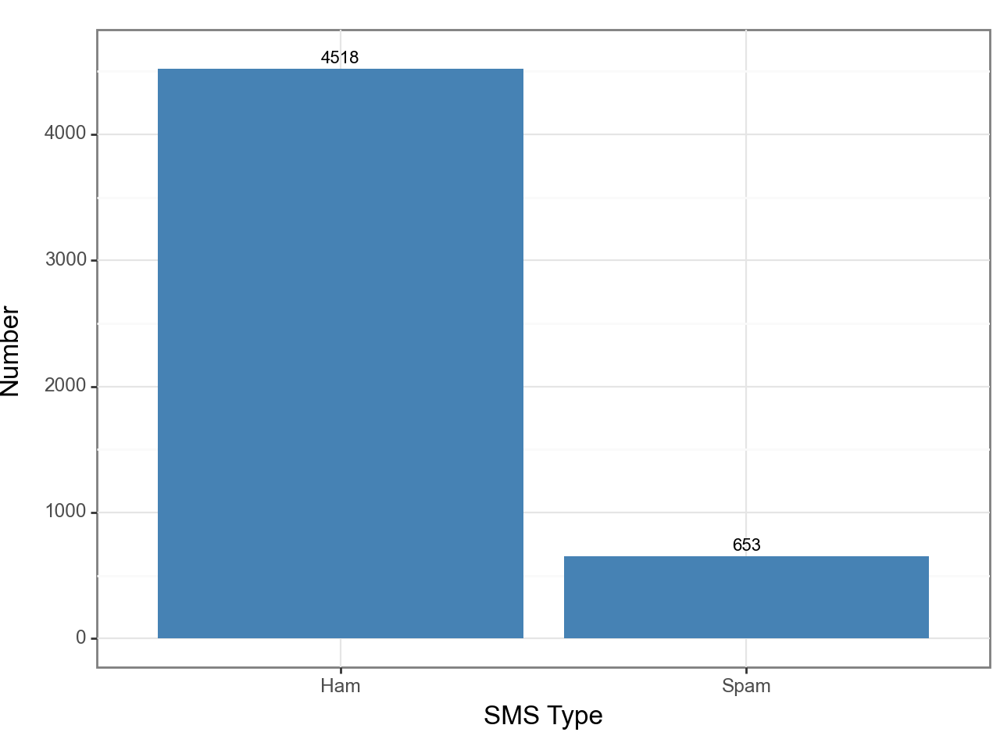

<Figure Size: (640 x 480)>

In [9]:
# Visualize the distribution of SMS type
ggplot(df_label, aes(x='label', y='number')) + \
    geom_bar(stat='identity', position='dodge', fill='steelblue') + \
    geom_text(aes(label='number'), nudge_y=80, size=8) + \
    labs( x='SMS Type', y='Number') + \
    theme_bw() + \
    theme(text= element_text(family='Arial'),
    title = element_text(hjust = 0.5, size = 12))

# title='Distribution of SMS Type',

In [9]:
# Create a variable called length to calculate the length of text
df['length'] = df['sms'].apply(lambda x: len(x.split()))
df.head()

,sms,label,Label,length
0,"Go until jurong point, crazy.. Available only ...",0,Ham,20
1,Ok lar... Joking wif u oni...\n,0,Ham,6
2,Free entry in 2 a wkly comp to win FA Cup fina...,1,Spam,28
3,U dun say so early hor... U c already then say...,0,Ham,11
4,"Nah I don't think he goes to usf, he lives aro...",0,Ham,13


In [11]:
df.length.describe()

count    5171.000000
mean       15.433765
std        11.102059
min         1.000000
25%         7.000000
50%        12.000000
75%        22.000000
max       171.000000
Name: length, dtype: float64

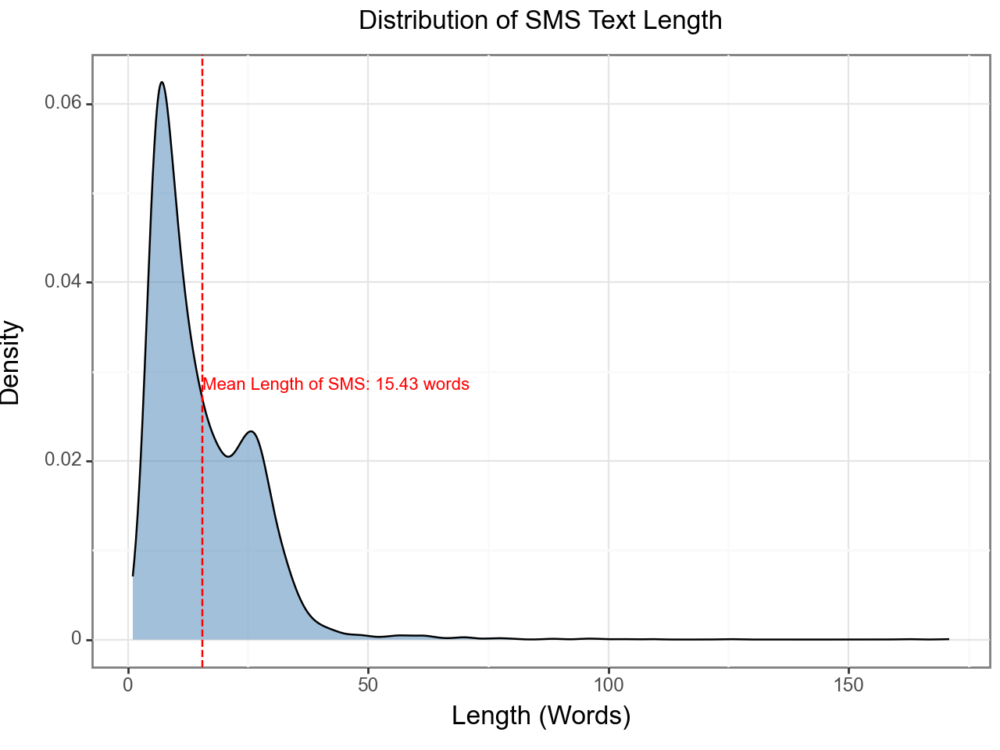

<Figure Size: (640 x 480)>

In [12]:
# Visualize the distribution of text length by using density plot
ggplot(df, aes(x='length')) + \
    geom_density(fill='steelblue', alpha=0.5) + \
    aes(y='stat(density)') +\
    theme_bw() + \
    theme(text=element_text(family='Arial'),
    title = element_text(hjust = 0.5, size = 12)) + \
    geom_vline(xintercept=df['length'].mean(), color='red', linetype='dashed') + \
    annotate(geom="text", 
        label=f"Mean Length of SMS: {df['length'].mean():.2f} words",
        x=df['length'].mean(),
        y=0.0285,
        size=8,
        color='red',
        ha='left',
        va='center',
        angle=0) + \
    labs(title='Distribution of SMS Text Length', x='Length (Words)', y='Density')

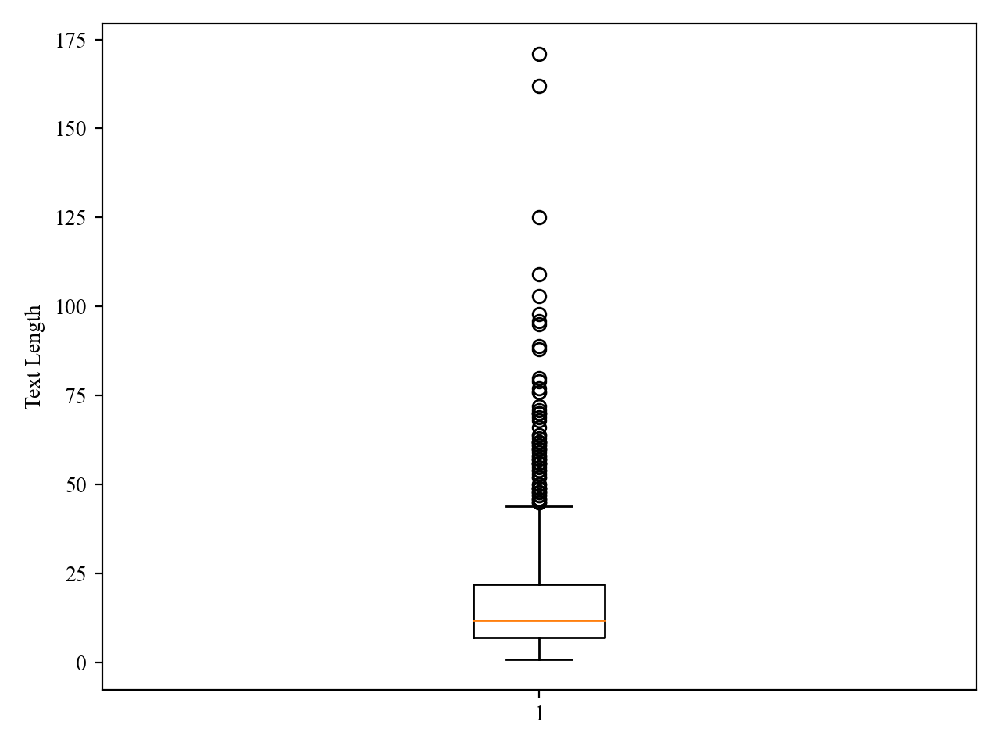

In [14]:
# Visualize the distribution of text length by using boxplot
plt.rcParams['font.family'] = 'Times New Roman'
plt.boxplot(df['length'])
plt.ylabel('Text Length')
#plt.title('Distribution of SMS Text Length')
plt.tight_layout()
plt.show()

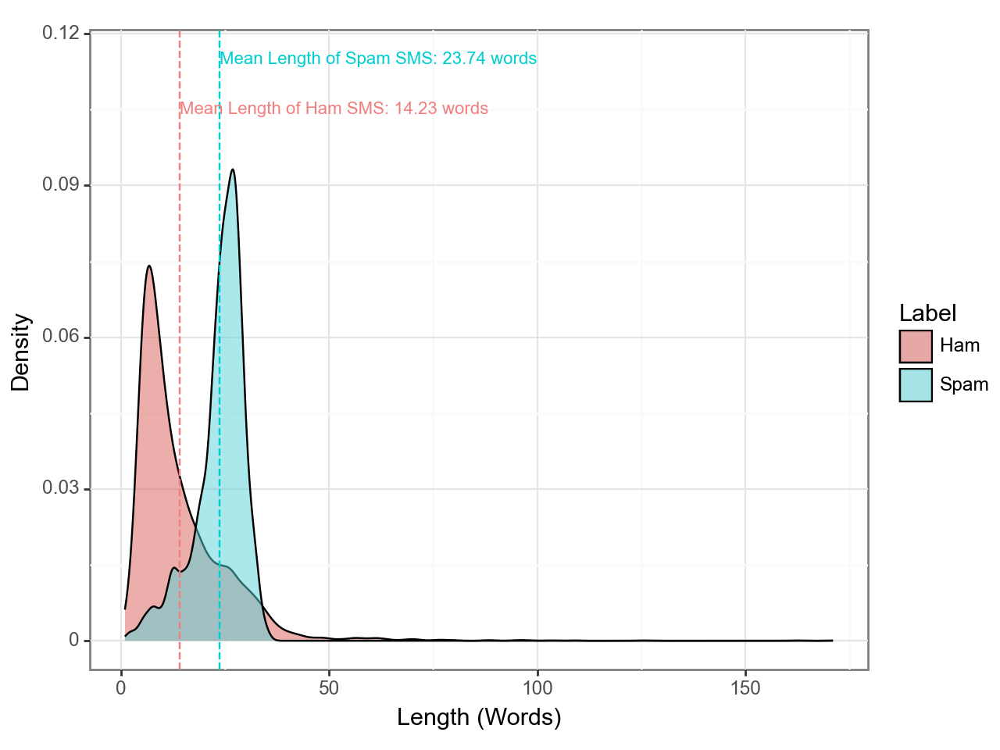

<Figure Size: (640 x 480)>

In [15]:
# Calculate mean length for Spam and Ham groups
mean_ham = df['length'][df.Label == 'Ham'].mean()
mean_spam = df['length'][df.Label == 'Spam'].mean()

# Divide different text type and check the length difference (density plot)
(ggplot(df) +
 aes(x='length', fill='Label') +
 geom_density(alpha=0.5) +
 geom_vline(xintercept=mean_ham, color='lightcoral', linetype='dashed') +
 geom_vline(xintercept=mean_spam, color='darkturquoise', linetype='dashed') +
 annotate(
     geom='text',
     label=f"Mean Length of Ham SMS: {mean_ham:.2f} words",
     x=mean_ham,
     y=0.105,
     size=8,
     color='lightcoral',
     ha='left',
     va='center') +
 annotate(
     geom='text',
     label=f"Mean Length of Spam SMS: {mean_spam:.2f} words",
     x=mean_spam,
     y=0.115,
     size=8,
     color='darkturquoise',
     ha='left',
     va='center'
 ) +
 labs( x='Length (Words)', y='Density') +
 theme_bw() +
 theme(text=element_text(family='Arial')))

# title='Distribution of SMS Text Length',

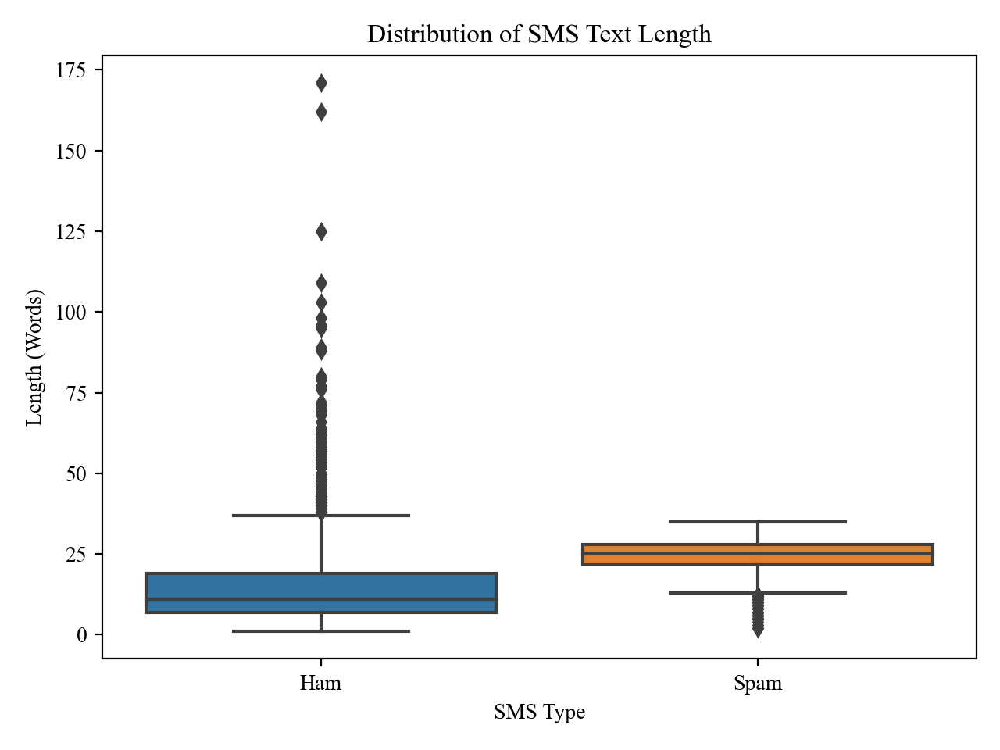

In [16]:
# Divide different text type and check the length difference (Boxplot)
sns.boxplot(x='Label', y='length', data=df)
plt.title('Distribution of SMS Text Length')
plt.xlabel('SMS Type')
plt.ylabel('Length (Words)')
plt.tight_layout()
plt.show()

#### Visualize the Word Cloud Pictures for Two SMS Types

In [10]:
# Generate the text contents
ham_text = " ".join(df[df.Label=='Ham']['sms'])
spam_text = " ".join(df[df.Label=='Spam']['sms'])

In [11]:
# Create word cloud pictures for two types
ham_wordcloud = WordCloud(width=800, height=800, background_color='white', colormap='Reds').generate(ham_text)
spam_wordcloud = WordCloud(width=800, height=800, background_color='white', colormap='Reds').generate(spam_text)

# Transform the word cloud into array
ham_image = ham_wordcloud.to_array()
spam_image = spam_wordcloud.to_array()

In [107]:
# Create a figure with two subplots and adjust figure width
fig, axes = plt.subplots(1, 2, figsize=(14, 6), dpi=600)

# Plot the Ham Messages Word Cloud with adjusted title settings
axes[0].imshow(ham_image, interpolation='bilinear')
axes[0].set_title('Ham Messages Word Cloud', fontsize=14, backgroundcolor='white')
axes[0].axis('off')

# Plot the Spam Messages Word Cloud with adjusted title settings
axes[1].imshow(spam_image, interpolation='bilinear')
axes[1].set_title('Spam Messages Word Cloud', fontsize=14, backgroundcolor='white')
axes[1].axis('off')

# Adjust subplot layout for better spacing
plt.tight_layout()

# Display the figure
plt.show()

#### Pre-process the text
Since the original text in the dataset contains some meaningless symbols and words, we should pre-process the text then run the model to make prediction.

In detail, we will take steps:
- Lowercasing: All words are converted to lowercase to ensure consistent comparison and analysis.
- Tokenization: We tokenize the text into individual words, splitting it based on spaces and punctuation marks.
- Lemmatization: We lemmatize the text to reduce a word to its root form.
- Stopword Removal: We eliminate common words (stopwords) that do not contribute significantly to the meaning of the text.

In [7]:
# Define a function to pre-process the text
def preprocess_text(text):
    text= text.lower() # Lowercasing
    text =text.replace("\n","") # Replace the meaningless character
    words = word_tokenize(text) # Tokenization
    lemmatizer = WordNetLemmatizer() 
    words=[lemmatizer.lemmatize(word=i, pos='v') for i in words] # Lemmatization
    words = [i for i in words if i not in stopwords.words("english")] # Stopword Removal
    return " ".join(words) # Concate tokens

In [8]:
# Execute the function
df['text'] = df['sms'].apply(preprocess_text)
df.head()

,sms,label,Label,text
0,"Go until jurong point, crazy.. Available only ...",0,Ham,"go jurong point , crazy .. available bugis n g..."
1,Ok lar... Joking wif u oni...\n,0,Ham,ok lar ... joke wif u oni ...
2,Free entry in 2 a wkly comp to win FA Cup fina...,1,Spam,free entry 2 wkly comp win fa cup final tkts 2...
3,U dun say so early hor... U c already then say...,0,Ham,u dun say early hor ... u c already say ...
4,"Nah I don't think he goes to usf, he lives aro...",0,Ham,"nah n't think go usf , live around though"


#### Use Vectorizer to Transform the Text and Check the Word Frequency

In [10]:
# Transform the text frequency into a matrix
tfidf_vectorizer = TfidfVectorizer(ngram_range=(1, 2)) # Combine both unigrams and bigrams
word_count = tfidf_vectorizer.fit_transform(df['text']).toarray()

In [11]:
# Save the array into a dataframe
count_df = pd.DataFrame(word_count, columns= tfidf_vectorizer.get_feature_names_out())
count_df.shape

(5171, 39001)

To address the issue of high dimensionality with 39,001 columns, we have opted to limit the maximum features to 3,000. This choice allows us to effectively reduce the dimensionality of the word frequency matrix by excluding the least frequently occurring words from our analysis.

In [9]:
# Decrease the dimension to 3000 to only generate the most frequent 3000 words
tfidf_vectorizer = TfidfVectorizer(max_features=3000, ngram_range=(1, 2))
word_count = tfidf_vectorizer.fit_transform(df['text']).toarray()

In [10]:
# Save the array into a dataframe
count_df = pd.DataFrame(word_count, columns= tfidf_vectorizer.get_feature_names_out())
count_df.head()

,00,00 sub,000,000 bonus,000 cash,02,02 06,03,03 2nd,04,...,yogasana,you,yr,yr prize,yrs,yummy,yun,yup,yup thk,zed
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [16]:
count_df.shape

(5171, 3000)

#### Run Machine Learning Model to Make Prediction
##### Split dataset into training and test set

In [11]:
# Set X and y value
X = word_count
y = df['label']

# Instantiate the RandomOverSampler 
ros = RandomOverSampler(random_state=42)

# Oversample the minority class
X_resampled, y_resampled = ros.fit_resample(X, y)

# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2,shuffle=True, stratify = y_resampled, random_state=2023)

##### Define a function to use grid search to fine-tune hyperparameters

In [12]:
# Define a function
def hyperparameter_tuning(model, param_grid):
    # Create a GridSearchCV object to perform hyperparameter tuning
    grid_search = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')
    
    # Fit the GridSearchCV object to your data
    grid_search.fit(X_train, y_train)
    
    # Get the best hyperparameters and the best model
    best_params = grid_search.best_params_
    best_model = grid_search.best_estimator_
    
    # Evaluate the best model on the test set
    test_accuracy = best_model.score(X_test, y_test)
    
    return best_params, test_accuracy

##### Naive Bayes Model

In [22]:
# Define the hyperparameters and their possible values
param_grid = {
    'alpha': [0.001, 0.01, 0.1, 1.0],  
}

# Create your Multinomial Naive Bayes model
model = MultinomialNB()

# Execute the function
best_params_nb, test_accuracy_nb = hyperparameter_tuning(model, param_grid)

print("Best Hyperparameters:", best_params_nb)
print("Test Accuracy:", test_accuracy_nb)

Best Hyperparameters: {'alpha': 0.001}
Test Accuracy: 0.9778761061946902


##### Logistic Regression Model

In [23]:
# Define the hyperparameters and their possible values
param_grid = {
    'penalty': ['l1', 'l2'],
    'C': [0.001, 0.01, 0.1]
}

# Create your Logistic Regression model
model = LogisticRegression(solver='liblinear') 

# Execute the function
best_params_log, test_accuracy_log = hyperparameter_tuning(model, param_grid)

print("Best Hyperparameters:", best_params_log)
print("Test Accuracy:", test_accuracy_log)

Best Hyperparameters: {'C': 0.1, 'penalty': 'l2'}
Test Accuracy: 0.9646017699115044


##### KNN Model

In [24]:
# Define the hyperparameters and their possible values
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]  # 1 for Manhattan distance (L1), 2 for Euclidean distance (L2)
}

# Create your K-Nearest Neighbors model
model = KNeighborsClassifier()

# Execute the function
best_params_knn, test_accuracy_knn = hyperparameter_tuning(model, param_grid)

print("Best Hyperparameters:", best_params_knn)
print("Test Accuracy:", test_accuracy_knn)

Best Hyperparameters: {'n_neighbors': 11, 'p': 1, 'weights': 'distance'}
Test Accuracy: 0.9983407079646017


##### Decision Tree Model

In [25]:
# Define the hyperparameters and their possible values
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10]
}

# Create your Decision Tree model
model = DecisionTreeClassifier()

# Execute the function
best_params_dt, test_accuracy_dt = hyperparameter_tuning(model, param_grid)

print("Best Hyperparameters:", best_params_dt)
print("Test Accuracy:", test_accuracy_dt)

Best Hyperparameters: {'criterion': 'entropy', 'max_depth': None, 'min_samples_split': 2}
Test Accuracy: 0.985066371681416


In [13]:
# Create and train the Decision Tree model
model = DecisionTreeClassifier(criterion='entropy', max_depth=None, min_samples_split=2)
model.fit(X_train, y_train)

# Get feature importances
feature_importance = model.feature_importances_

# Create a DataFrame and sort the DataFrame by importance values in descending order
importance_dt = pd.DataFrame({'Feature': tfidf_vectorizer.get_feature_names_out(), 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Print the top 20 important word
importance_dt.head(20)

,Feature,Importance
455,call,0.198976
2671,txt,0.144956
984,free,0.071068
2941,www,0.060934
2535,text,0.042879
1732,msg,0.035040
2254,service,0.027937
2889,win,0.017848
2618,tone,0.014690
2347,sms,0.014656


##### Random Forest Model

In [26]:
# Define the hyperparameters and their possible values
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10]
}

# Create your Random Forest model
model = RandomForestClassifier()

# Execute the function
best_params_rf, test_accuracy_rf = hyperparameter_tuning(model, param_grid)

print("Best Hyperparameters:", best_params_rf)
print("Test Accuracy:", test_accuracy_rf)

Best Hyperparameters: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 100}
Test Accuracy: 0.9961283185840708


In [14]:
# Create and train the Random Forest model
model = RandomForestClassifier(max_depth=None, min_samples_split=2, n_estimators=100)
model.fit(X_train, y_train)

# Get feature importances
feature_importance = model.feature_importances_

# Create a DataFrame and sort the DataFrame by importance values in descending order
importance_rf = pd.DataFrame({'Feature': tfidf_vectorizer.get_feature_names_out(), 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Print the top 20 important word
importance_rf.head(20)

,Feature,Importance
455,call,0.059473
2671,txt,0.042720
984,free,0.041351
2889,win,0.025015
1682,mobile,0.022677
2136,reply,0.020872
2941,www,0.019035
540,claim,0.018144
2535,text,0.017808
2254,service,0.017465


##### XGBoost Model

In [27]:
# Define the hyperparameters and their possible values
param_grid = {
    'learning_rate': [0.1, 0.2],
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 4, 5]
}

# Create your XGBoost model
model = XGBClassifier()

# Execute the function
best_params_xgb, test_accuracy_xgb = hyperparameter_tuning(model, param_grid)

print("Best Hyperparameters:", best_params_xgb)
print("Test Accuracy:", test_accuracy_xgb)

Best Hyperparameters: {'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 300}
Test Accuracy: 0.9961283185840708


In [15]:
# Create and train the XGBoost model
model = XGBClassifier(learning_rate=0.2, max_depth=5, n_estimators=300)
model.fit(X_train, y_train)

# Get feature importances
feature_importance = model.feature_importances_

# Create a DataFrame and sort the DataFrame by importance values in descending order
importance_xgb = pd.DataFrame({'Feature': tfidf_vectorizer.get_feature_names_out(), 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Print the top 20 important word
importance_xgb.head(20)

,Feature,Importance
2671,txt,0.080074
2941,www,0.077346
455,call,0.041847
2136,reply,0.025626
1732,msg,0.024857
984,free,0.023377
494,cash,0.020835
2423,stop,0.018473
2535,text,0.017079
2684,uk,0.016878


##### SVM Model

In [28]:
# Define the hyperparameters and their possible values
param_grid = {
    'C': [0.001, 0.01, 0.1],
    'kernel': ['linear', 'rbf'],
}

# Create your SVC model
model = SVC()

# Execute the function
best_params_svc, test_accuracy_svc = hyperparameter_tuning(model, param_grid)

print("Best Hyperparameters:", best_params_svc)
print("Test Accuracy:", test_accuracy_svc)

Best Hyperparameters: {'C': 0.1, 'kernel': 'linear'}
Test Accuracy: 0.974004424778761


#### Compare Models' Performance

In [33]:
mol = ['Naive Bayes Model','Logistic Regression Model','KNN Model', 'Decision Tree Model', 'Random Forest Model', 'XGBoost Model', 'SVM Model']
par = [best_params_nb, best_params_log, best_params_knn, best_params_dt, best_params_rf, best_params_xgb, best_params_svc]
acc = [test_accuracy_nb, test_accuracy_log, test_accuracy_knn, test_accuracy_dt, test_accuracy_rf, test_accuracy_xgb, test_accuracy_svc]
per = pd.DataFrame({'Model': mol, 'Parameter': par,'accuracy': acc})
per['Accuracy'] = round(per.accuracy*100,3)
per

,Model,Parameter,accuracy,Accuracy
0,Naive Bayes Model,{'alpha': 0.001},0.977876,97.788
1,Logistic Regression Model,"{'C': 0.1, 'penalty': 'l2'}",0.964602,96.460
2,KNN Model,"{'n_neighbors': 11, 'p': 1, 'weights': 'distan...",0.998341,99.834
3,Decision Tree Model,"{'criterion': 'entropy', 'max_depth': None, 'm...",0.985066,98.507
4,Random Forest Model,"{'max_depth': None, 'min_samples_split': 2, 'n...",0.996128,99.613
5,XGBoost Model,"{'learning_rate': 0.2, 'max_depth': 5, 'n_esti...",0.996128,99.613
6,SVM Model,"{'C': 0.1, 'kernel': 'linear'}",0.974004,97.400


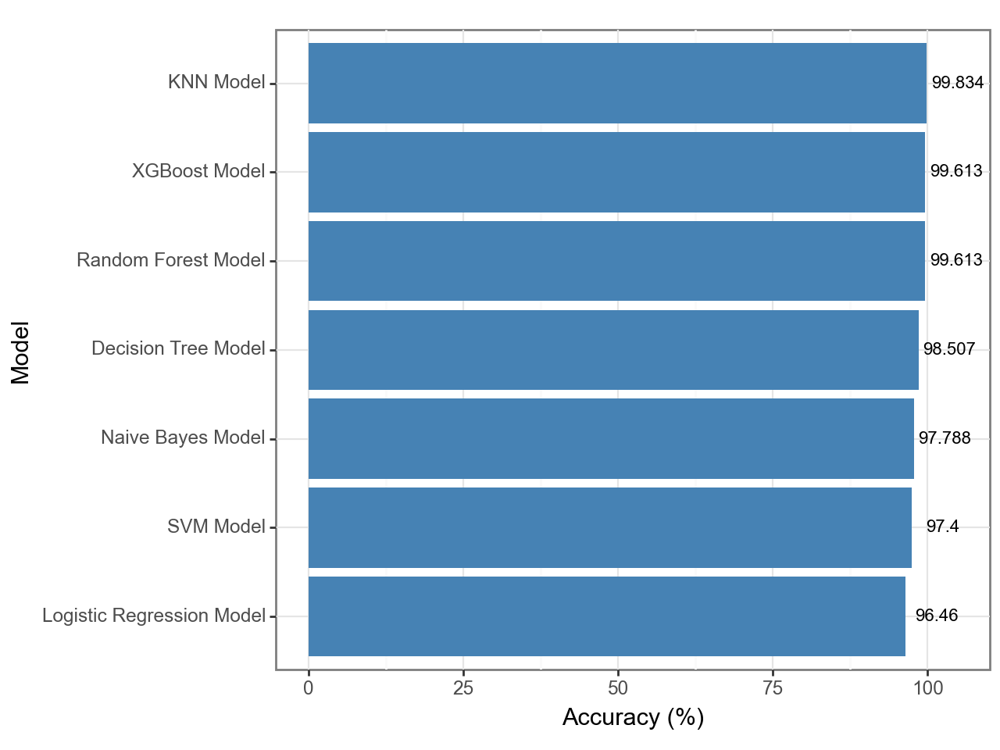

<Figure Size: (640 x 480)>

In [34]:
# Rank by Accuracy
order = per.sort_values(by='Accuracy')['Model'].unique()

# Create the bar plot
ggplot(per, aes(x='Model', y='Accuracy')) + \
    geom_bar(stat='identity', position='dodge', fill='steelblue') + \
    geom_text(aes(label='Accuracy'), nudge_y=5, size=8) + \
    scale_x_discrete(limits=order) + \
    labs(x='Model', y='Accuracy (%)') + \
    theme_bw() + \
    theme(text=element_text(family='Arial'),
          plot_title=element_text(hjust=0.5, size=12)) + \
    coord_flip() 

# title='Comparison of Model Prediction Accuracy',

#### View the most important word/word terms in tree-based models

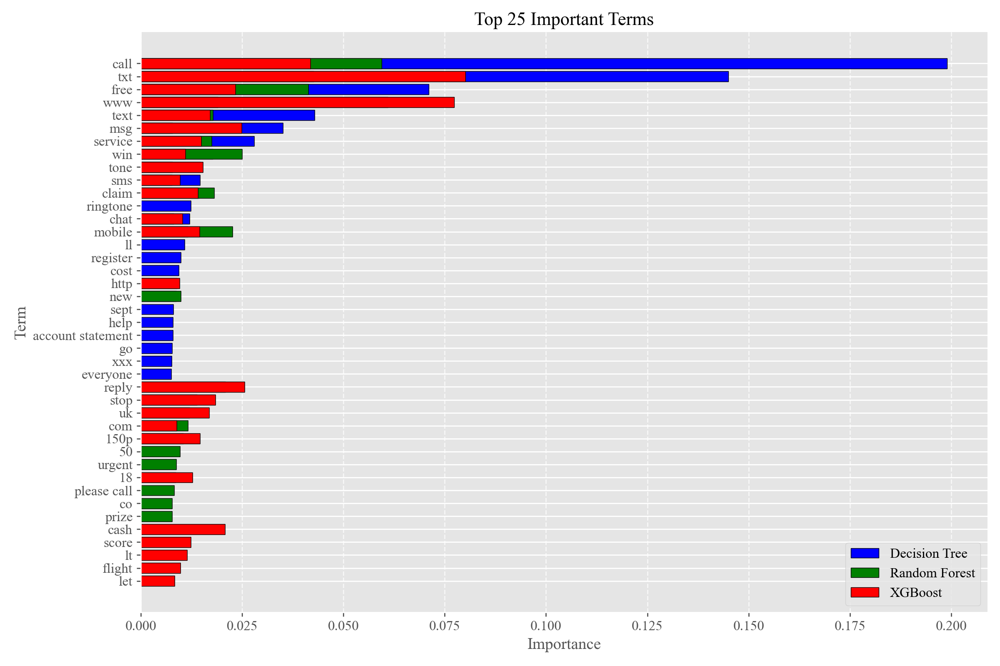

In [60]:
plt.rcParams['text.usetex'] = False
plt.rcParams['text.latex.preamble'] = r'\usepackage{amsmath}'
plt.rcParams['text.usetex'] = False


# Combine the data frames into one and add a model column
importance_dt['model'] = 'Decision Tree'
importance_rf['model'] = 'Random Forest'
importance_xgb['model'] = 'XGBoost'

importance_combined = pd.concat([importance_dt, importance_rf, importance_xgb], ignore_index=True)

# Create a dictionary to map models to colors
model_colors = {
    'Decision Tree': 'blue',
    'Random Forest': 'green',
    'XGBoost': 'red',
}

# Group the data by the model column
grouped = importance_combined.groupby('model')

# Set the style for better aesthetics
plt.style.use('ggplot')

# Create a figure and axis
fig, ax = plt.subplots(figsize=(12, 8))

# Plot the grouped bar charts
for name, group in grouped:
    ax.barh(group['Feature'][:25], group['Importance'][:25], label=name, color=model_colors[name], edgecolor='black')

# Invert the order for better visualization
ax.invert_yaxis()

# Add a title
ax.set_title('Top 25 Important Terms', fontsize=16)

# Customize labels and legends
ax.set_xlabel('Importance', fontsize=14)
ax.set_ylabel('Term', fontsize=14)
ax.legend(fontsize=12)

# Add grid lines
ax.grid(axis='x', linestyle='--', alpha=0.7)

# Improve aesthetics
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', labelsize=12)
plt.tight_layout()

# Display the plot
plt.show()


#### View the Best model's Performance

In [22]:
knn_final = KNeighborsClassifier(n_neighbors=11, p=1, weights='distance')
knn_final.fit(X_train, y_train)
y_pred=knn_final.predict(X_test)

In [38]:
con_matrix = confusion_matrix(y_test, y_pred)

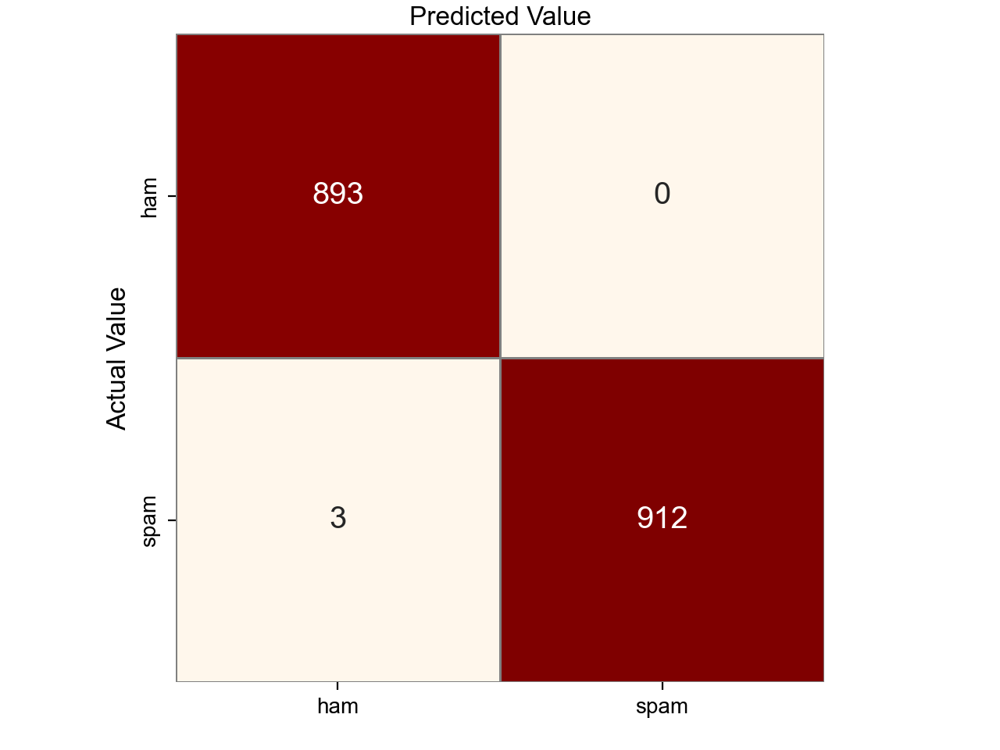

In [39]:
def plot_confusion_matrix(cnf_matrix, description):
    class_names = ["ham", "spam"] 
    fig, ax = plt.subplots()
    tick_marks = np.arange(len(class_names))

    # Create a heatmap
    sns.set(font_scale=1.2)  # Adjust font size
    sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap='OrRd', fmt='g', cbar=False,
                linewidths=0.5, linecolor='gray', square=True, robust=True)

    ax.xaxis.set_label_position('top')
    plt.tight_layout()

    plt.title(description, y=1.1, fontsize=16)
    plt.ylabel('Actual Value', fontsize=12)
    plt.xlabel('Predicted Value', fontsize=12)

    # Set the tick labels in the middle of the axes
    ax.set_xticks(np.arange(len(class_names)) + 0.5, minor=False)
    ax.set_yticks(np.arange(len(class_names)) + 0.5, minor=False)

    # Set the tick labels
    ax.set_xticklabels(class_names)
    ax.set_yticklabels(class_names)

    plt.show()
    
plot_confusion_matrix(con_matrix,'Confusion matrix -- Random Forest Model')